# Analyzing Data with Jupyter Notebook

This notebook is based in part on the Data Science Handbook by Jake VanderPlas that you can find [here](https://colab.research.google.com/github/jakevdp/PythonDataScienceHandbook/blob/master/notebooks/Index.ipynb)



## IPython Tips

Here are a few tips that will help you get started using a Jupyter Notebook.

### Tip 1 - Help

You can use the ? character at the end of a function or type to access the help for that function or type.

In [1]:
# Let's create a list and see how to get the length
v = [1.0, 2.0, 3.0]
len?

Signature: len(obj, /)
Docstring: Return the number of items in a container.
Type:      builtin_function_or_method

In [2]:
len(v)

3

In [3]:
# We can even get information about the list itself:
v?

Type:        list
String form: [1.0, 2.0, 3.0]
Length:      3
Docstring:  
Built-in mutable sequence.

If no argument is given, the constructor creates a new empty list.
The argument must be an iterable if specified.

In [4]:
# Let's create a function with a helpful description
def empty_function():
  """This is just an empty function. Please don't call it."""
  return 1

In [5]:
# Now the description is available by asking for help
empty_function?

Signature: empty_function()
Docstring: This is just an empty function. Please don't call it.
File:      /tmp/ipykernel_4971/3378048660.py
Type:      function

In [6]:
# Two question marks will display the source for the function
empty_function??

Signature: empty_function()
Source:   
def empty_function():
  """This is just an empty function. Please don't call it."""
  return 1
File:      /tmp/ipykernel_4971/3378048660.py
Type:      function

### Tip 2 - Tab Completion

Well, I was going to add a section about how to use the \<TAB\> key to autocomplete, but it appears that Colab already has that feature built into the editor.

Just in case, try the command 

?>v.\<TAB\> 

below:

### Tip 3 - Magic Commands

No really, they are called magic because they start with a '%'

One of the most useful commands that can be used to split up a large notebook is the %run magic command. Using it, you
can run external python scripts or even IPython notebooks 
inside the context of the current notebook.

An example of this can be found in the HSV-AI Bug Analysis notebook [here](https://colab.research.google.com/github/HSV-AI/bug-analysis/blob/master/Doc2Vec.ipynb)

Two other very useful magic commands are **%time** and **%timeit**


In [7]:
# Using an example directly from VanderPlas:
print("Here's the output of the %timeit command:")
%timeit L = [n ** 2 for n in range(1000)]

print("\nHere's the output of the %time command:")
%time  L = [n ** 2 for n in range(1000)]

Here's the output of the %timeit command:
42.5 µs ± 651 ns per loop (mean ± std. dev. of 7 runs, 10,000 loops each)

Here's the output of the %time command:
CPU times: user 41 µs, sys: 0 ns, total: 41 µs
Wall time: 47.4 µs


### Tip 4 - Suppressing Output

Jupyter will send the result of the last command from a cell to the output. Sometimes you just want it to stay quiet though - especically if you are generating plots and other items that do not need the ouput text inserted.

In order to suppress the output, just end the line with a ';'

In [8]:
# This code has output
p1 = 'This little piggy had roast beef'
p1

'This little piggy had roast beef'

In [9]:
# This code does not have output
p2 = 'This little piggy had none'
p2;

### Tip 5 - %history Magic

This particular piece of magic is very helpful when you may have run cells out of order and are trying to troubleshoot what happened in what order.

In [10]:
%history

# Let's create a list and see how to get the length
v = [1.0, 2.0, 3.0]
len?
len(v)
# We can even get information about the list itself:
v?
# Let's create a function with a helpful description
def empty_function():
  """This is just an empty function. Please don't call it."""
  return 1
# Now the description is available by asking for help
empty_function?
# Two question marks will display the source for the function
empty_function??
# Using an example directly from VanderPlas:
print("Here's the output of the %timeit command:")
%timeit L = [n ** 2 for n in range(1000)]

print("\nHere's the output of the %time command:")
%time  L = [n ** 2 for n in range(1000)]
# This code has output
p1 = 'This little piggy had roast beef'
p1
# This code does not have output
p2 = 'This little piggy had none'
p2;
%history


### Tip 6- Shell Commands

Most Linux shell commands are available from the Jupyter notebook as well. One good example is shown below and sets us up to start doing some data analysis.

In [11]:
!wget https://data.nasa.gov/api/views/gh4g-9sfh/rows.csv

--2024-01-19 17:05:14--  https://data.nasa.gov/api/views/gh4g-9sfh/rows.csv
Resolving data.nasa.gov (data.nasa.gov)... 128.102.186.77, 2001:4d0:6311:2c05:60b0:5ad8:1210:ea07
Connecting to data.nasa.gov (data.nasa.gov)|128.102.186.77|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: unspecified [text/csv]
Saving to: ‘rows.csv.3’

rows.csv.3              [      <=>           ]   3.77M  2.86MB/s    in 1.3s    

2024-01-19 17:05:16 (2.86 MB/s) - ‘rows.csv.3’ saved [3952161]



## NASA Data

The data that we will be analyzing is described [HERE](https://data.nasa.gov/Space-Science/Meteorite-Landings/gh4g-9sfh)

This comprehensive data set from The Meteoritical Society contains information on all of the known meteorite landings. The Fusion Table is collected by Javier de la Torre and we've also provided an XLS file that consists of 34,513 meteorites.

## Pandas Dataframes

[https://pandas.pydata.org/](https://pandas.pydata.org/)

pandas is an open source, BSD-licensed library providing high-performance, easy-to-use data structures and data analysis tools for the Python programming language.

Pandas datafames are a great way to work with tabular data.

There are several ways to load a dataframe from common file formats like json and csv.


In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

df = pd.read_csv('../data/Meteorite_Landings.csv')

# Now let's look at the columns available in the dataframe
print(df.columns)
print(df.dtypes)

Index(['name', 'id', 'nametype', 'recclass', 'mass (g)', 'fall', 'year',
       'reclat', 'reclong', 'GeoLocation'],
      dtype='object')
name            object
id               int64
nametype        object
recclass        object
mass (g)       float64
fall            object
year           float64
reclat         float64
reclong        float64
GeoLocation     object
dtype: object


In [2]:
# We can also get an idea of the data by using the head function
df.head()

,name,id,nametype,recclass,mass (g),fall,year,reclat,reclong,GeoLocation
0,Aachen,1,Valid,L5,21.0,Fell,1880.0,50.77500,6.08333,"(50.775, 6.08333)"
1,Aarhus,2,Valid,H6,720.0,Fell,1951.0,56.18333,10.23333,"(56.18333, 10.23333)"
2,Abee,6,Valid,EH4,107000.0,Fell,1952.0,54.21667,-113.00000,"(54.21667, -113.0)"
3,Acapulco,10,Valid,Acapulcoite,1914.0,Fell,1976.0,16.88333,-99.90000,"(16.88333, -99.9)"
4,Achiras,370,Valid,L6,780.0,Fell,1902.0,-33.16667,-64.95000,"(-33.16667, -64.95)"


## Dataframe copy vs view

One thing to keep in mind when working with Pandas is the behavior differences with working with a copy of a dataframe vs a view/reference of a dataframe.

Working with a copy keeps your changes separate, but causes more memory overhead than working with a view.

In [3]:
# We can copy columns of the dataframe into a new dataframe
df_copy = df[['name', 'id']]

df_copy.head()

,name,id
0,Aachen,1
1,Aarhus,2
2,Abee,6
3,Acapulco,10
4,Achiras,370


In [4]:
# We can see that these two items point to different memory addresses

print(id(df))
print(id(df_copy))

139968698356688
139968701243024


In [5]:
# Changes to the copy do not affect the original
df_copy['id'] = 0
print('\nCopy')
print(df_copy.head())

print('\nOriginal')
print(df.head())


Copy
       name  id
0    Aachen   0
1    Aarhus   0
2      Abee   0
3  Acapulco   0
4   Achiras   0

Original
       name   id nametype     recclass  mass (g)  fall    year    reclat  \
0    Aachen    1    Valid           L5      21.0  Fell  1880.0  50.77500   
1    Aarhus    2    Valid           H6     720.0  Fell  1951.0  56.18333   
2      Abee    6    Valid          EH4  107000.0  Fell  1952.0  54.21667   
3  Acapulco   10    Valid  Acapulcoite    1914.0  Fell  1976.0  16.88333   
4   Achiras  370    Valid           L6     780.0  Fell  1902.0 -33.16667   

     reclong           GeoLocation  
0    6.08333     (50.775, 6.08333)  
1   10.23333  (56.18333, 10.23333)  
2 -113.00000    (54.21667, -113.0)  
3  -99.90000     (16.88333, -99.9)  
4  -64.95000   (-33.16667, -64.95)  


/tmp/ipykernel_16946/2644006673.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_copy['id'] = 0


In [6]:
# We can also create a view of the dataframe
df_view = df.iloc[:,:]

print(id(df_view))
print(id(df))

139968614642640
139968698356688


In [7]:
# Changes to the view also update the dataframe
df_view.iloc[:, 1] = 0

print('This is the data in df_view:')
print(df_view.head)

print('This is the data in the original dataframe:')
print(df.head)

This is the data in df_view:
<bound method NDFrame.head of              name  id nametype              recclass  mass (g)   fall    year  \
0          Aachen   0    Valid                    L5      21.0   Fell  1880.0   
1          Aarhus   0    Valid                    H6     720.0   Fell  1951.0   
2            Abee   0    Valid                   EH4  107000.0   Fell  1952.0   
3        Acapulco   0    Valid           Acapulcoite    1914.0   Fell  1976.0   
4         Achiras   0    Valid                    L6     780.0   Fell  1902.0   
...           ...  ..      ...                   ...       ...    ...     ...   
45711  Zillah 002   0    Valid               Eucrite     172.0  Found  1990.0   
45712      Zinder   0    Valid  Pallasite, ungrouped      46.0  Found  1999.0   
45713        Zlin   0    Valid                    H4       3.3  Found  1939.0   
45714   Zubkovsky   0    Valid                    L6    2167.0  Found  2003.0   
45715  Zulu Queen   0    Valid                  L3

## Updating values in a Dataframe

In this case, we can see that some of the values for year are using floating point numbers, and some of them are NaN. We would like to convert those to integer values and remove the rows where the year is NaN.

In [8]:
print(df.year.describe())
print('\nNumber of NaN:')
print(df.year.isna().sum())


count    45425.000000
mean      1991.828817
std         25.052766
min        860.000000
25%       1987.000000
50%       1998.000000
75%       2003.000000
max       2101.000000
Name: year, dtype: float64

Number of NaN:
291


# Applying a function to column

In the cell below, we define a function called updateDate that takes the floating point value as an input and returns an integer value of the date. If the date is a NaN, we return a value of 0, which we can filter out later.

In [9]:
import math

def updateDate(x):
  if isinstance(x, float):
    if math.isnan(x):
        return 0
    return int(x)
  else:
    return int(x[6:10])
  
df.year = df.year.apply(lambda x: updateDate(x))


In [10]:
df.year

0        1880
1        1951
2        1952
3        1976
4        1902
         ... 
45711    1990
45712    1999
45713    1939
45714    2003
45715    1976
Name: year, Length: 45716, dtype: int64

In [11]:
df = df[df.year > 0]

## Matplotib

[https://matplotlib.org/](https://matplotlib.org/)

Matplotlib is a Python 2D plotting library which produces publication quality figures in a variety of hardcopy formats and interactive environments across platforms. Matplotlib can be used in Python scripts, the Python and IPython shells, the Jupyter notebook, web application servers, and four graphical user interface toolkits.

There are also some helper methods from Pandas that will automatically create a plot in matplotlib for you.

In [12]:
df.head()

,name,id,nametype,recclass,mass (g),fall,year,reclat,reclong,GeoLocation
0,Aachen,0,Valid,L5,21.0,Fell,1880,50.77500,6.08333,"(50.775, 6.08333)"
1,Aarhus,0,Valid,H6,720.0,Fell,1951,56.18333,10.23333,"(56.18333, 10.23333)"
2,Abee,0,Valid,EH4,107000.0,Fell,1952,54.21667,-113.00000,"(54.21667, -113.0)"
3,Acapulco,0,Valid,Acapulcoite,1914.0,Fell,1976,16.88333,-99.90000,"(16.88333, -99.9)"
4,Achiras,0,Valid,L6,780.0,Fell,1902,-33.16667,-64.95000,"(-33.16667, -64.95)"


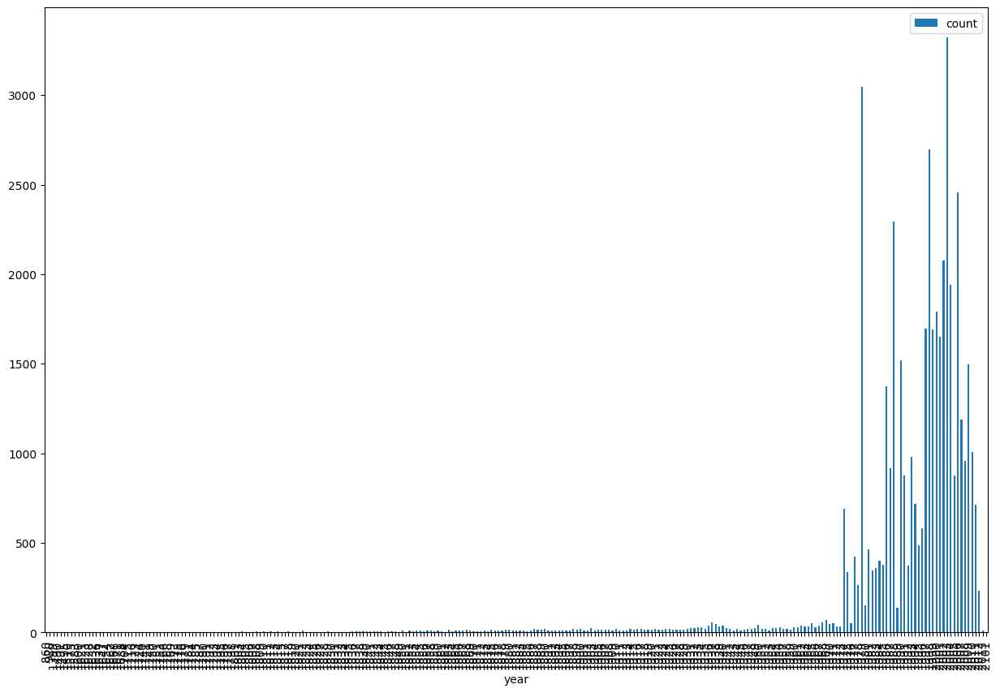

In [13]:
# First, let's put together a plot of the number of meteorite landings per year

grouped = df.loc[:,['id','year']].groupby('year').count()
grouped.columns = ['count']
grouped.sort_values(by='year').plot(kind='bar', figsize=(15,10))
plt.show()

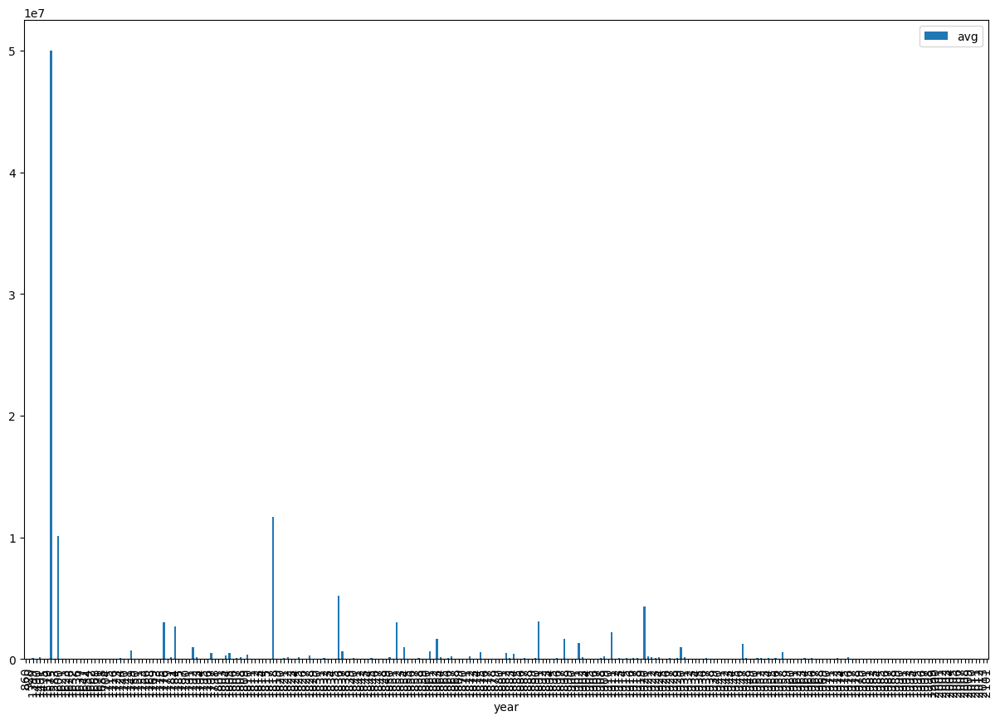

In [14]:
# Since we have the mass of each meteorite, we might as well figure
# out the mean per year and plot that as well.

grouped = df.loc[:,['mass (g)','year']].groupby('year').mean()
grouped.columns = ['avg']
grouped.sort_values(by='year').plot(kind='bar', figsize=(15,10))
plt.show()

### Installing Basemap on Colab

In [2]:
import os
import mapboxgl
from IPython.display import IFrame

# token = os.getenv('MAPBOX_ACCESS_TOKEN')
token = "pk.eyJ1IjoianBlcmlvZGxhbmdsZXkiLCJhIjoiY2xybWtqaHQ0MTBqbTJsa2lzM2FjczNkaSJ9.sHrOPfDbuY1p6vD8A1Z8Aw"
os.environ["MAPBOX_ACCESS_TOKEN"] = token

In [9]:
df = df.dropna()

# data_url = 'https://raw.githubusercontent.com/mapbox/mapboxgl-jupyter/master/examples/data/points.csv'
# df2 = pd.read_csv(data_url).round(3)
# df2.date = 0

# print(str(df2.head(2)))

geodata = mapboxgl.utils.df_to_geojson(df, 
              lat='reclat', 
              lon='reclong')

viz = mapboxgl.viz.CircleViz(geodata,
                radius=2, 
                center=(-95, 40),
                zoom=3)

viz.show()

name           38115
id             38115
nametype       38115
recclass       38115
mass (g)       38115
fall           38115
year           38115
reclat         38115
reclong        38115
GeoLocation    38115
dtype: int64
name           38115
id             38115
nametype       38115
recclass       38115
mass (g)       38115
fall           38115
year           38115
reclat         38115
reclong        38115
GeoLocation    38115
dtype: int64


/home/jlangley/miniconda3/envs/starter-kit/lib/python3.11/site-packages/IPython/core/display.py:431: UserWarning: Consider using IPython.display.IFrame instead
  warnings.warn("Consider using IPython.display.IFrame instead")


In [3]:
# NGMDB monochorome style designed to provide a basemap that highlights the data overlay.
ngmdbLight = "https://ngmdb-tiles.usgs.gov/styles/ngmdb-light/style.json"

# NGMDB full-color style that contains standard cartographic basemap layers, contour lines, and hillshading.
ngmdbBasemap = "https://ngmdb-tiles.usgs.gov/styles/ngmdb-tv/style.json"

# Call the USWTDB API and apply custom URL parameters to the request. Parameters allow us to filter the data return.
data_url = "https://eersc.usgs.gov/api/uswtdb/v1/turbines?&t_cap=gt.0&select=case_id,t_manu,t_cap,xlong,ylat"

# Parse the JSON response from the API return and populate the dataframe
dfClusterMap = pd.read_json(data_url)

# Preview the first five records of our dataframe based on the custom URL paramters in the API request
dfClusterMap.head(5)




,case_id,t_manu,t_cap,xlong,ylat
0,3123985,Vestas,4200,-99.78703,36.50172
1,3123544,Vestas,4200,-99.72562,36.43713
2,3123887,Vestas,4200,-99.76972,36.44493
3,3123765,Vestas,4200,-99.80706,36.51394
4,3123814,Vestas,4200,-99.75848,36.44498


In [4]:
# Create GeoJSON object with selected attributes. Define coordinates to three decimal places. Map required lat lon.
turbineClusterGeoJson = mapboxgl.utils.df_to_geojson(
    dfClusterMap,
    properties=["case_id", "t_cap", "t_manu"],
    precision=3,
    lat="ylat",
    lon="xlong",
)

In [8]:
# Define our color stops based on a 6-step divergent color ramp
turbine_color_stops = mapboxgl.utils.create_color_stops(
    [10, 50, 100, 500, 1000, 5000], colors="Spectral"
)

# Define the radius (sizes) of the cluster markers
turbine_radius_stops = [[1, 5], [10, 10], [1000, 15], [5000, 20]]

# Define the parameters for our cluster map
# Call our NGMDB style as basemap, set the max zoom level for clusters to show
# Set cluster label sizze and cluster symbol opacity
# Handle initial zoom/center of visualization
turbineClustersMap = mapboxgl.viz.ClusteredCircleViz(
    turbineClusterGeoJson,
    color_stops=turbine_color_stops,
    radius_stops=turbine_radius_stops,
    # style=ngmdbLight,
    cluster_maxzoom=10,
    label_size=10,
    opacity=0.6,
    center=(-95, 40),
    zoom=3.25,
)

# Render the cluster map visualization
turbineClustersMap.show()

In [10]:
viz = mapboxgl.viz.CircleViz(turbineClusterGeoJson,
                radius=2, 
                center=(-95, 40),
                zoom=3)

viz.show()

In [ ]:
!apt-get install libgeos-3.5.0
!apt-get install libgeos-dev
!pip install https://github.com/matplotlib/basemap/archive/master.zip

In [ ]:
!pip install pyproj==1.9.6

### Geographic Map

In [ ]:
#@title Year of Impact
#@markdown Forms support many types of fields.
year = 2007 #@param {type:"slider", min:2000, max:2010, step:1}
#@markdown ---


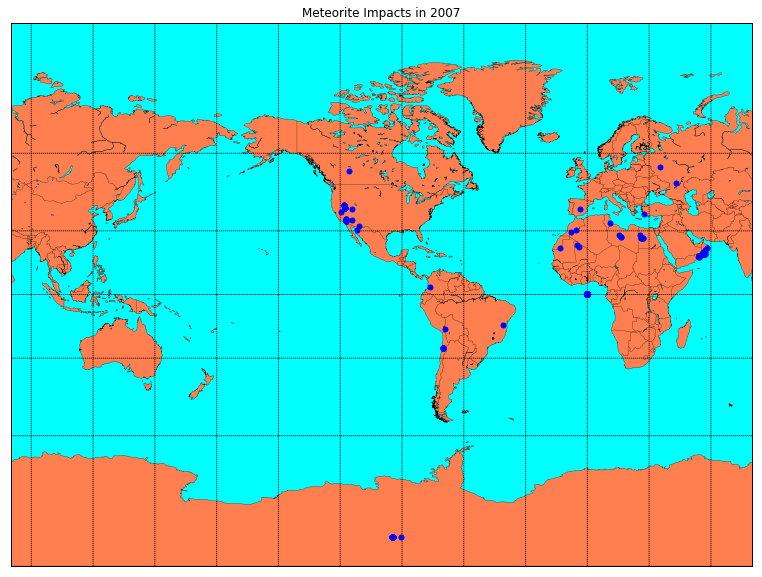

In [35]:
from mpl_toolkits.basemap import Basemap

plt.figure(figsize=(15,10))

map = Basemap(projection='mill',lat_0=0,lon_0=-100,resolution='l')
# draw coastlines, country boundaries, fill continents.
map.drawcoastlines(linewidth=0.25)
map.drawcountries(linewidth=0.25)
map.fillcontinents(color='coral',lake_color='aqua')
# draw the edge of the map projection region (the projection limb)
map.drawmapboundary(fill_color='aqua')
# draw lat/lon grid lines every 30 degrees.
map.drawmeridians(np.arange(0,360,30))
map.drawparallels(np.arange(-90,90,30))

df_year = df[df.year == year]
x,y = map(df_year.reclong.values, df_year.reclat.values)
map.plot(x, y, 'bo', markersize=5)

plt.title('Meteorite Impacts in '+str(year))
plt.show()

## Wrap-up

So, that's a quick introduction to doing Data Analysis with Jupyter Notebook.

If you have any questions, please drop me a line at:

[https://hsv-ai.com/contact/](https://hsv-ai.com/contact/)